# Temporal Analysis of Difference in Temperature between EMIRS and MCD
## Data Source:
### EMIRS: L3ATM via SDC API (Filtered for Temperature Flags. TSURFGOOD = 1]
### MCD: Lat Lon from EMIRS Filtered data fed to MCD to get predicted Temperatures
#### COMPARISON of DIfference

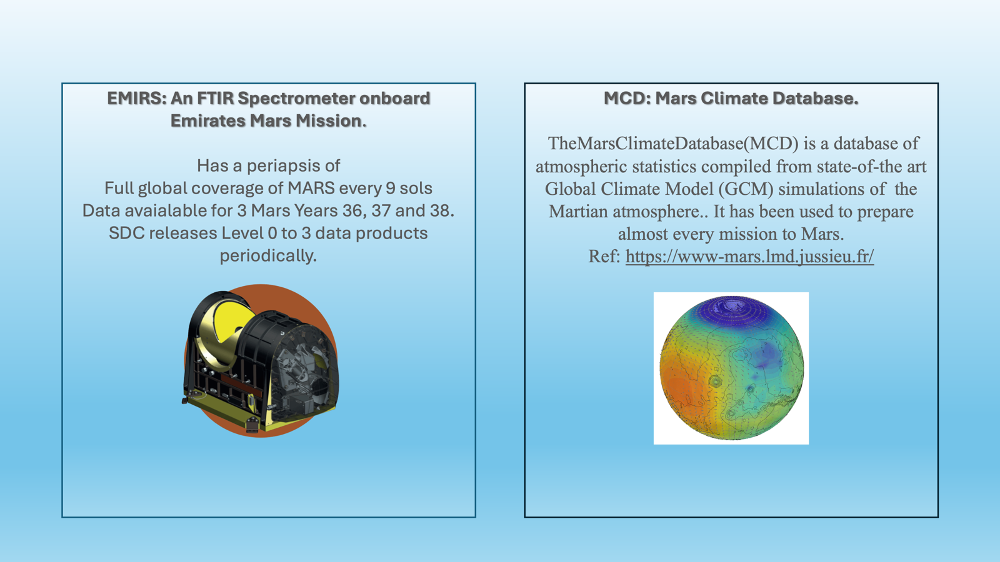

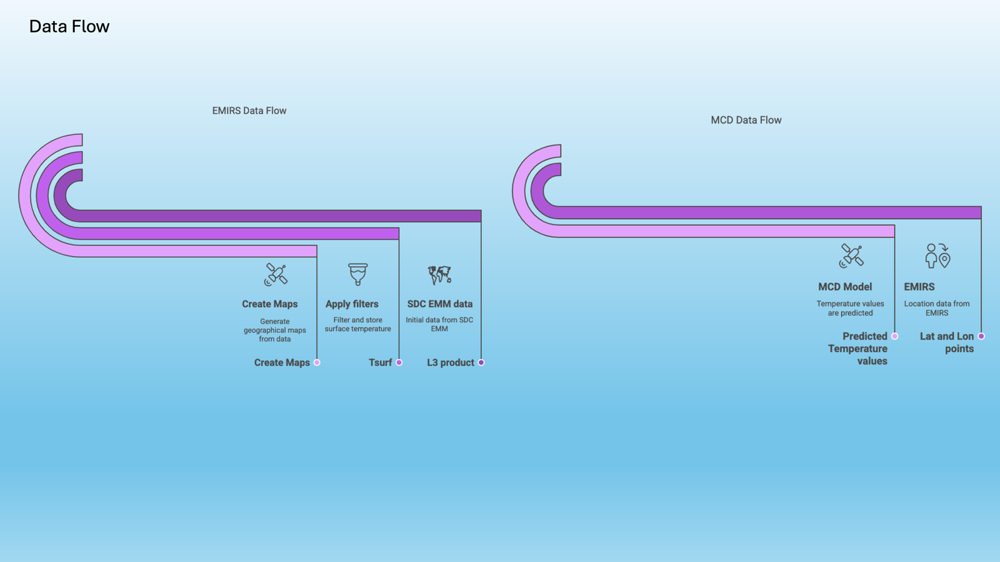



In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scienceplots
plt.style.use(['science', 'notebook'])

### We have already fed the filtered EMIRS data for Ls: 0 to 20, MY 37 to MCD and stored the o/p values
### We access those files here

In [2]:
# EMIRS file 

path = "/scratch/pk97/01_mcd_surf_temp/mcd_input/"
filename = "l3atm_ls_0_30.csv"
df_l3atm = pd.read_csv(path + filename)
df_l3atm.head(5)

,sclk,sclk_sub,det_num,target_type_num,utc,incidence,emission,phase,bore_flag,nfov,...,longitude,qlt,qshgt,target_range,sc_altitude,dustgood,icegood,watergood,tempgood,tsurfgood
0,667210741,32832,5,3,2021-02-26 21:22:01.85,79.813194,82.649470,142.18858,1,-0.113990,...,15.470306,6.652222,40174.265625,40174.265625,36779.468750,0.0,0.0,0.0,1.0,1.0
1,667210743,32862,5,3,2021-02-26 21:22:03.851,84.446556,72.628940,142.60994,1,-0.690369,...,9.853742,6.278333,40175.191406,40175.191406,36780.394531,2.0,0.0,0.0,1.0,1.0
2,667210749,32939,5,3,2021-02-26 21:22:09.852,76.845450,71.184430,143.84381,1,-0.786932,...,18.454172,6.853333,40177.964844,40177.964844,36783.171875,2.0,0.0,0.0,1.0,1.0
3,667210773,33259,5,3,2021-02-26 21:22:33.857,94.447570,70.866714,141.36081,1,-0.865863,...,-3.351724,5.406111,40189.058594,40189.058594,36794.265625,0.0,0.0,0.0,1.0,1.0
4,667210775,33281,5,3,2021-02-26 21:22:35.857,97.225450,62.525010,141.78426,1,-1.756651,...,-4.841428,5.307222,40189.984375,40189.984375,36795.187500,0.0,0.0,0.0,1.0,1.0


In [3]:
# MCD Output

path_mcd = "/scratch/pk97/01_mcd_surf_temp/mcd_output/"
filename_mcd = "ls_0_30_mcd_output_tsurfgood.csv"
df_mcd = pd.read_csv(path_mcd + filename_mcd)
df_mcd.head(5)

,sclk,sclk_sub,qls,qlt,latitude,longitude,pressure,density,temp_mcd,zonwind,merwind,meanvar,extvar,seedout,ierr
0,667210741,32832,9.560391,6.652222,37.889423,15.470306,725.370300,0.021119,181.065094,0.0,0.0,[7.2537024e+02 2.1118613e-02 1.8106509e+02 0.0...,[ 3.3868468e+06 -2.3197378e+03 0.0000000e+00 ...,156091744.0,0
1,667210743,32862,9.560403,6.278333,26.780947,9.853742,722.548279,0.022955,168.600952,-0.0,0.0,[ 7.2254828e+02 2.2954775e-02 1.6860095e+02 ...,[ 3.3899288e+06 -2.2460015e+03 0.0000000e+00 ...,0.0,0
2,667210749,32939,9.560436,6.853333,6.507823,18.454172,611.853088,0.018290,187.030014,-0.0,0.0,[ 6.1185309e+02 1.8290406e-02 1.8703001e+02 ...,[ 3.3953912e+06 -2.8468103e+02 0.0000000e+00 ...,0.0,0
3,667210773,33259,9.560571,5.406111,37.938286,-3.351724,805.097290,0.023452,175.193359,-0.0,0.0,[ 8.0509729e+02 2.3451591e-02 1.7519336e+02 ...,[ 3.3854118e+06 -3.4881440e+03 0.0000000e+00 ...,0.0,0
4,667210775,33281,9.560582,5.307222,27.694828,-4.841428,716.813721,0.021086,171.306778,-0.0,0.0,[ 7.1681378e+02 2.1086104e-02 1.7130678e+02 ...,[ 3.3894782e+06 -2.2677646e+03 0.0000000e+00 ...,0.0,0


In [4]:
# Create a filter for Ls 0 to 20 for both files

con_mcd = (df_mcd['qls'] >= 0) & (df_mcd['qls'] <= 20)
con_l3atm = (df_l3atm['qls'] >= 0) & (df_l3atm['qls'] <= 20)
df_mcd = df_mcd[con_mcd].reset_index(drop=True)
df_l3atm = df_l3atm[con_l3atm].reset_index(drop=True)


In [5]:
# Total number of records 

len(df_mcd), len(df_l3atm), max(df_mcd['qls']), max(df_l3atm['qls'])


(90489, 90489, 19.997127532958984, 19.997127532958984)

Merge these two files for convenience

In [6]:
merged_df = pd.merge(df_l3atm, df_mcd, on=['sclk', 'sclk_sub'], how='inner')
len(merged_df)

90489

How many years of data is present

In [7]:
merged_df['year'] = merged_df['utc'].str[:4] 

In [8]:
merged_df['year'].value_counts()

year
2023    60147
2021    18900
2022    11442
Name: count, dtype: int64

Data for 2021

In [9]:
merged_df[merged_df['year']=='2021']['utc'].min(), merged_df[merged_df['year']=='2021']['utc'].max()

('2021-02-20 11:25:34.943', '2021-03-17 23:40:29.363')

Data for 2022 

In [10]:
merged_df[merged_df['year']=='2022']['utc'].min(), merged_df[merged_df['year']=='2022']['utc'].max()

('2022-12-26 10:55:48.823', '2022-12-31 22:14:08.818')

Data for 2023

In [11]:
merged_df[merged_df['year']=='2023']['utc'].min(), merged_df[merged_df['year']=='2023']['utc'].max()

('2023-01-01 00:57:56.679', '2023-02-05 17:05:42.464')

So we have 2 slices of data for `ls: 0 to 20 corressponding to 2 Mars Years

Lets choose 2022 & 2023 -> Corressponding to Mars Year 37

In [12]:
# filter for a single MARS year. 
# in our case for year 2022 and 2023 as they are Mars Year 37 Ls 0 - 20

merged_df = merged_df[(merged_df['year'] ==  '2022') | (merged_df['year'] ==  '2023') ]
merged_df = merged_df.reset_index(drop=True)
merged_df.head(5)

,sclk,sclk_sub,det_num,target_type_num,utc,incidence,emission,phase,bore_flag,nfov,...,pressure,density,temp_mcd,zonwind,merwind,meanvar,extvar,seedout,ierr,year
0,725165155,26633,5,3,2022-12-29 15:50:49.66,161.48488,68.649470,100.624626,1,-0.904527,...,630.734619,0.016684,190.870682,-0.0,0.0,[ 6.3073462e+02 1.6684135e-02 1.9087068e+02 ...,[ 3.3934592e+06 -8.7129993e+02 0.0000000e+00 ...,0.0,0,2022
1,725165159,26634,5,3,2022-12-29 15:50:53.66,162.19280,64.360270,100.659290,1,-1.307007,...,644.802612,0.017023,192.009827,-0.0,0.0,[ 6.4480261e+02 1.7022930e-02 1.9200983e+02 ...,[ 3.3939228e+06 -1.1173041e+03 0.0000000e+00 ...,0.0,0,2022
2,725165163,26633,5,3,2022-12-29 15:50:57.66,161.99922,61.766956,100.692850,1,-1.583699,...,647.932739,0.017087,192.012268,-0.0,0.0,[ 6.4793274e+02 1.7086672e-02 1.9201227e+02 ...,[ 3.3942945e+06 -1.1706044e+03 0.0000000e+00 ...,0.0,0,2022
3,725165167,26635,5,3,2022-12-29 15:51:01.66,161.15875,60.502120,100.725365,1,-1.728136,...,652.785217,0.017044,194.268311,-0.0,0.0,[ 6.5278516e+02 1.7044410e-02 1.9426831e+02 ...,[ 3.3943375e+06 -1.2728396e+03 0.0000000e+00 ...,0.0,0,2022
4,725165171,26634,5,3,2022-12-29 15:51:05.66,159.78975,60.408653,100.758170,1,-1.740431,...,656.360168,0.017147,194.635986,-0.0,-0.0,[ 6.5636011e+02 1.7147241e-02 1.9463599e+02 ...,[ 3.3941020e+06 -1.3504885e+03 0.0000000e+00 ...,0.0,0,2022


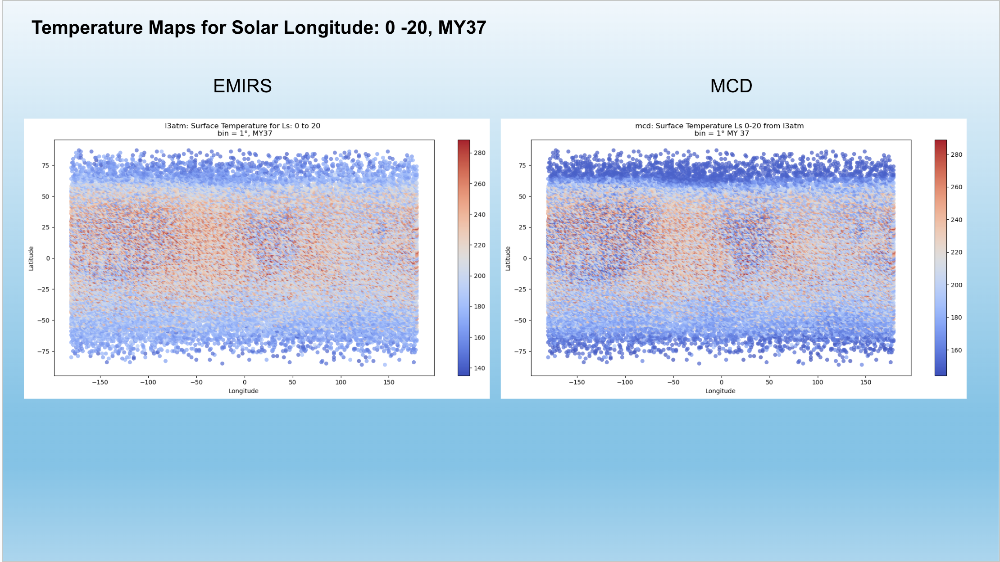

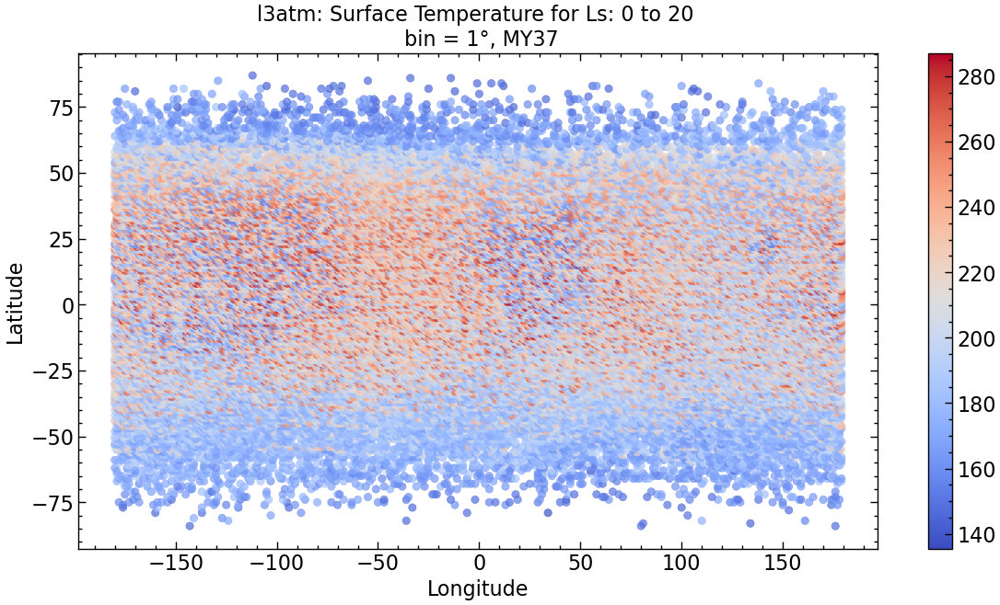

In [17]:
# Plot EMIRS Temperature plot for Ls: 0 to 20, MY 37
plt.style.use(['science', 'notebook'])
plt.rcParams['figure.figsize'] = (14, 7)

# rounding emirs latitude, longitudes, and local times
merged_df[['latitude_fl', 'longitude_fl']] = np.floor(merged_df[['latitude_x', 'longitude_y']])

# grouping by latitude and longitude
emirs = merged_df[['latitude_fl', 'longitude_fl', 
                  'tsurf']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = emirs, x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'tsurf', ec = None, alpha = 0.7)

norm = plt.Normalize(emirs['tsurf'].min(), emirs['tsurf'].max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title('l3atm: Surface Temperature for Ls: 0 to 20 \n bin = 1\u00b0, MY37')

plt.show()

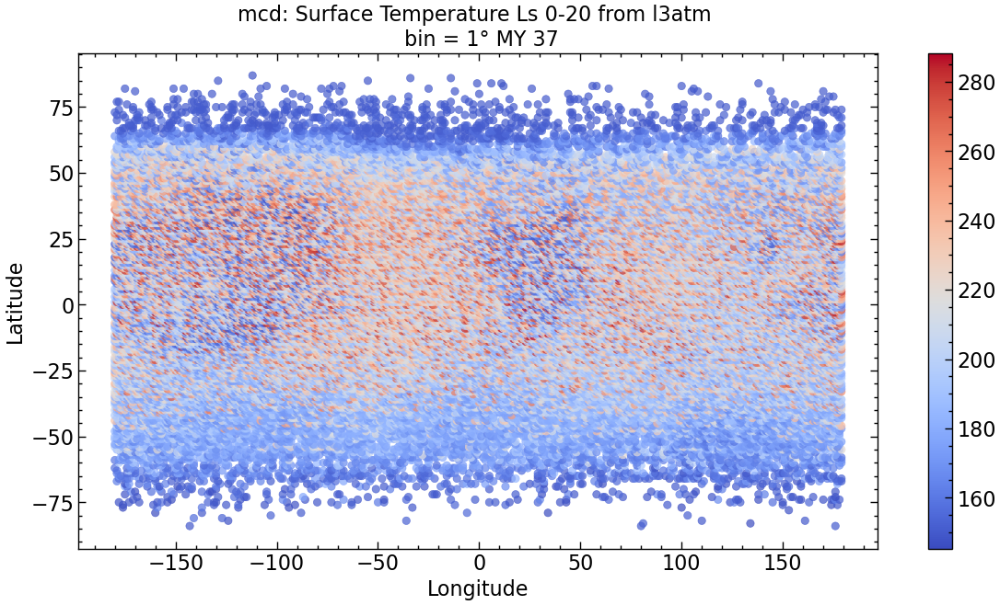

In [18]:
# Plot corressponding MCD values

plt.rcParams['figure.figsize'] = (14, 7)

# grouping by latitude and longitude
mcd = merged_df[['latitude_fl', 'longitude_fl', 
                  'temp_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = mcd, x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'temp_mcd', ec = None, alpha = 0.7)

norm = plt.Normalize(mcd['temp_mcd'].min(), mcd['temp_mcd'].max())
sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title('mcd: Surface Temperature Ls 0-20 from l3atm \n bin = 1\u00b0 MY 37')

plt.show()

In [19]:
# Calculate percent and absolute difference

merged_df['emirs_pctdiff'] = ((merged_df['tsurf'] - merged_df['temp_mcd']) / merged_df['tsurf']) * 100
merged_df['mcd_pctdiff'] = ((merged_df['temp_mcd'] - merged_df['tsurf']) / merged_df['temp_mcd']) * 100
merged_df['diff_mcd'] = merged_df['temp_mcd'] - merged_df['tsurf']
merged_df['diff_emirs'] = merged_df['tsurf'] - merged_df['temp_mcd']

Emission Angles of greater than 70 are problematic, are noisy and incorrect. So we filter these out

In [20]:
# filter out emission angle > 70
merged_df = merged_df[merged_df['emission'] <= 70]
len(merged_df)

65728

In [21]:
# filter out latitude

#lat_con = (merged_df['latitude_x'] <= 60) & (merged_df['latitude_x'] >= -60)
#merged_df = merged_df[lat_con].reset_index(drop=True)
#merged_df

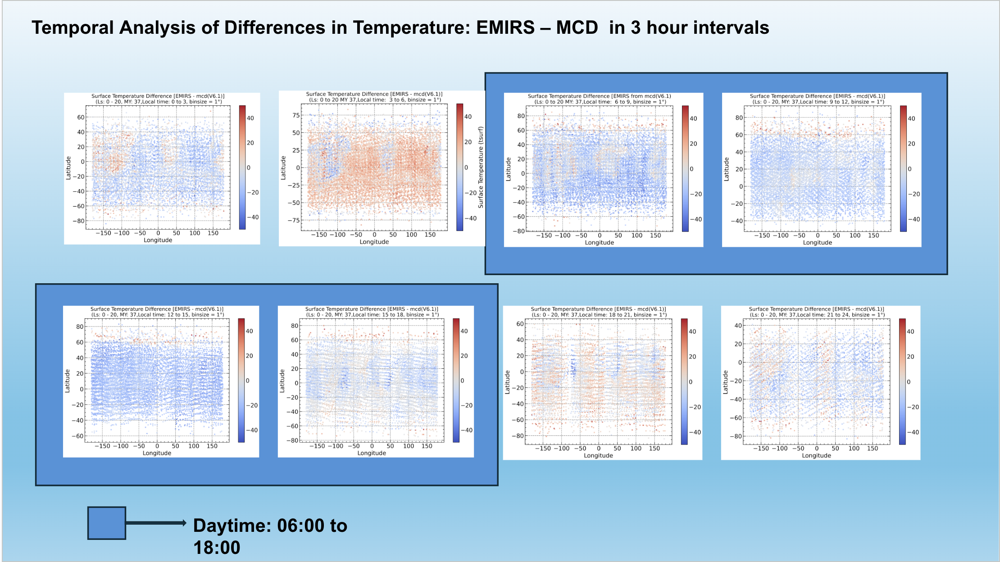

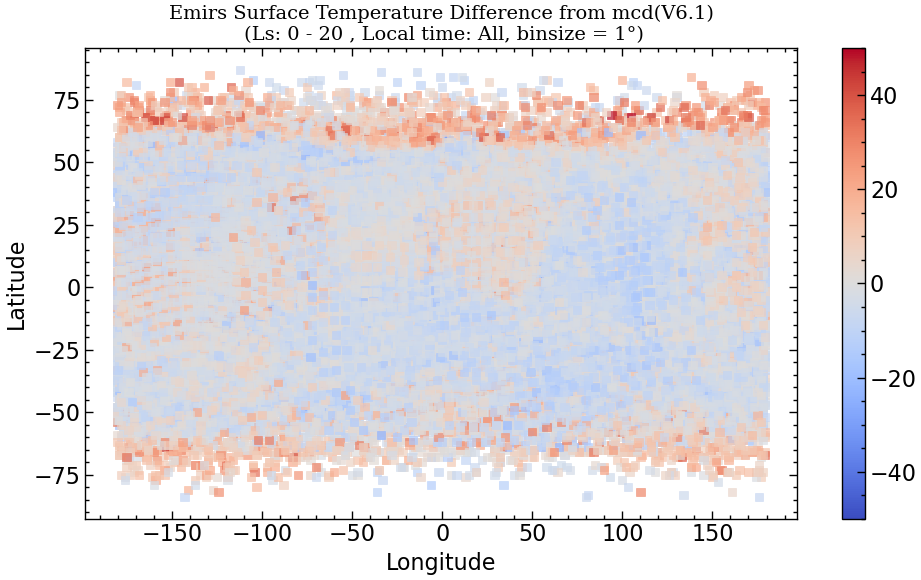

In [24]:
plt.style.use(['science', 'notebook'])
plt.figure(figsize=(10, 6))  
ax = sns.scatterplot(data = merged_df, x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title('Emirs Surface Temperature Difference from mcd(V6.1)\n (Ls: 0 - 20 , Local time: All, binsize = 1\u00b0)',
         fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_All_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')
#plt.show()

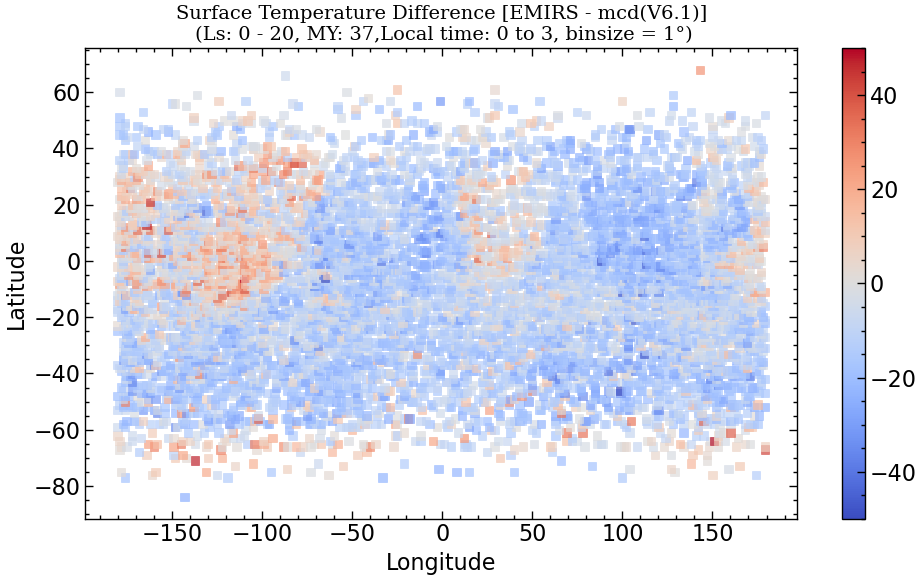

In [25]:

start_time = 0
end_time = 3

plt.figure(figsize=(10, 6))  

temp_df_03 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_03 = temp_df_03[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_03, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_0_3_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

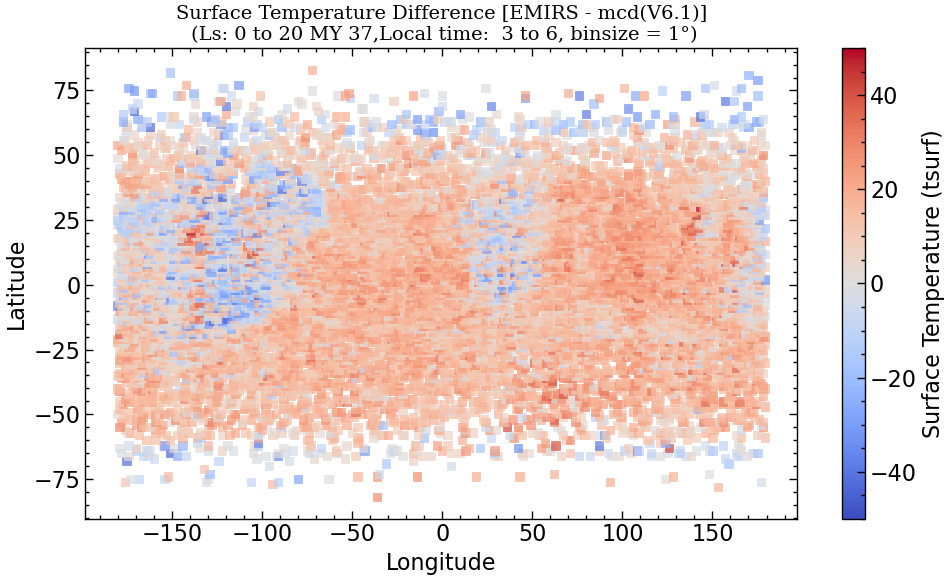

In [26]:
# grouping by latitude and longitude
start_time = 3
end_time = 6

plt.figure(figsize=(10, 6))  

temp_df_36 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_36 = temp_df_36[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'mcd_pctdiff', 'emirs_pctdiff']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_36, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'mcd_pctdiff', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 to 20 MY 37,\
Local time:  {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_3_6_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

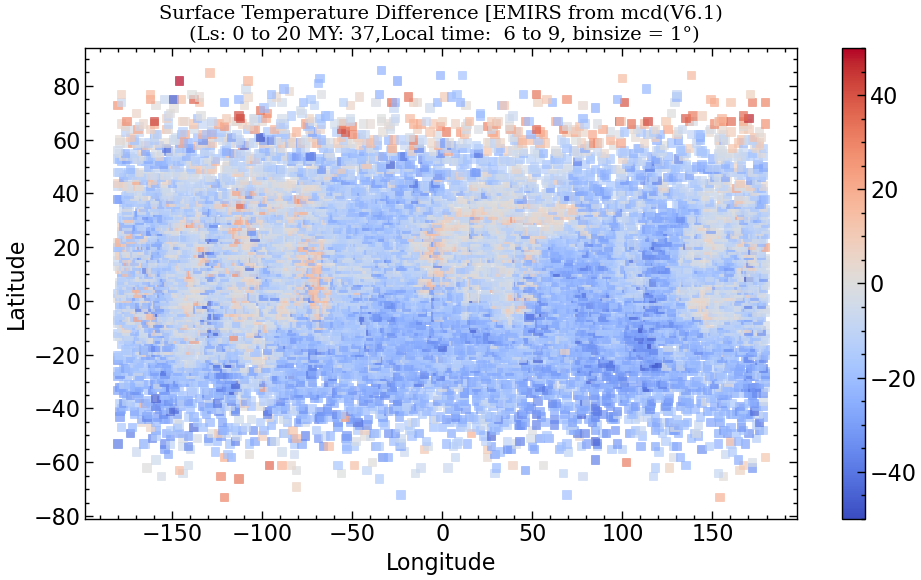

In [27]:
# grouping by latitude and longitude
start_time = 6
end_time = 9

plt.figure(figsize=(10, 6))  

temp_df_69 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_69 = temp_df_69[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_69, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Surface Temperature Difference [EMIRS from mcd(V6.1)\n (Ls: 0 to 20 MY: 37,\
Local time:  {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_6_9_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

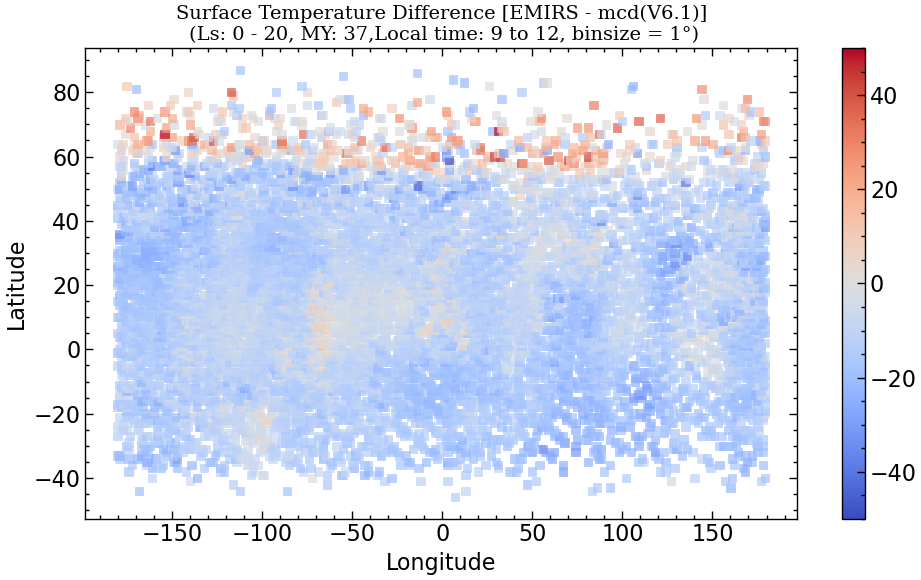

In [28]:
# grouping by latitude and longitude
start_time = 9
end_time = 12

plt.figure(figsize=(10, 6))  

temp_df_912 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_912 = temp_df_912[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_912, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_9_12_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

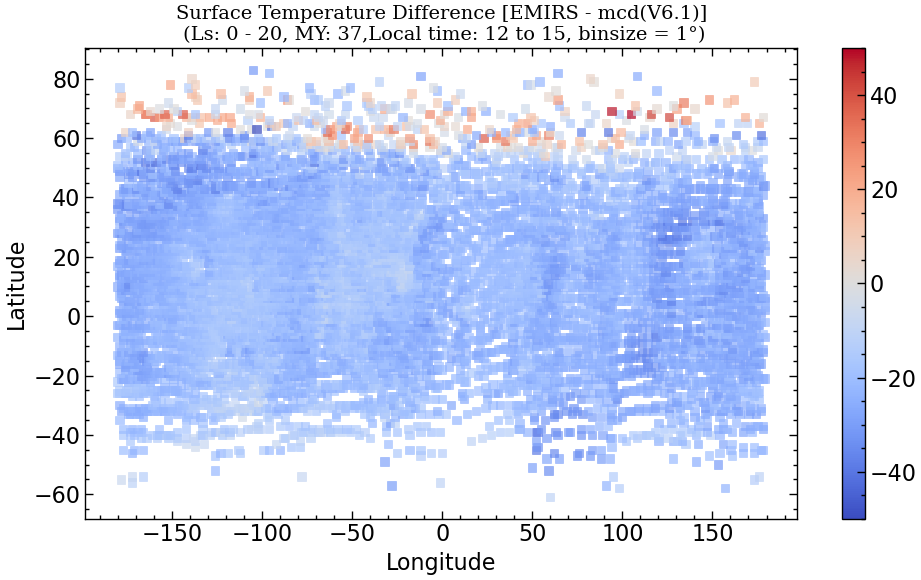

In [29]:
# grouping by latitude and longitude
start_time = 12
end_time = 15

plt.figure(figsize=(10, 6))  

temp_df_1215 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_1215 = temp_df_1215[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_1215, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_12_15_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

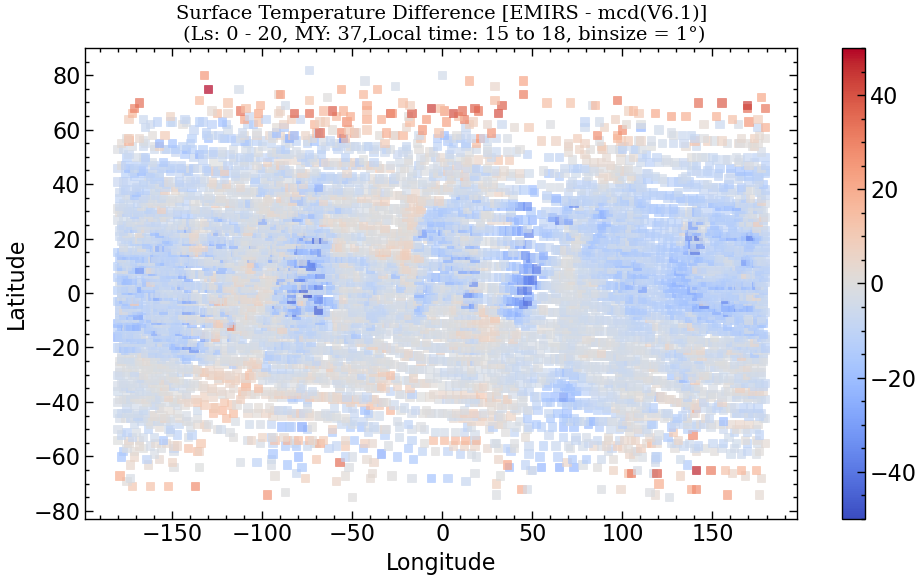

In [30]:
# grouping by latitude and longitude
start_time = 15
end_time = 18

plt.figure(figsize=(10, 6))  

temp_df_1518 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_1518 = temp_df_1518[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_1518, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_15_18_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

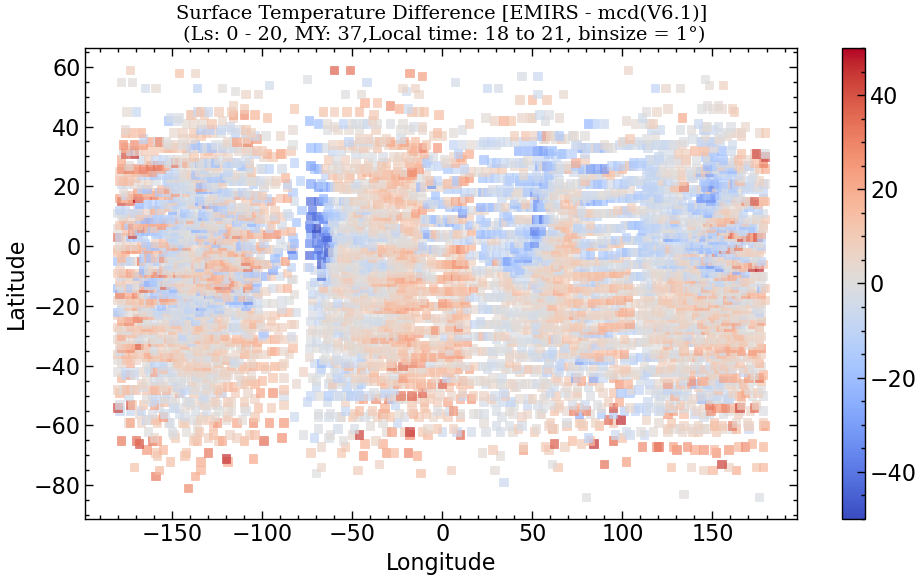

In [31]:
# grouping by latitude and longitude
start_time = 18
end_time = 21

plt.figure(figsize=(10, 6))  

temp_df_1821 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_1821 = temp_df_1821[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_1821, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_18_21_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

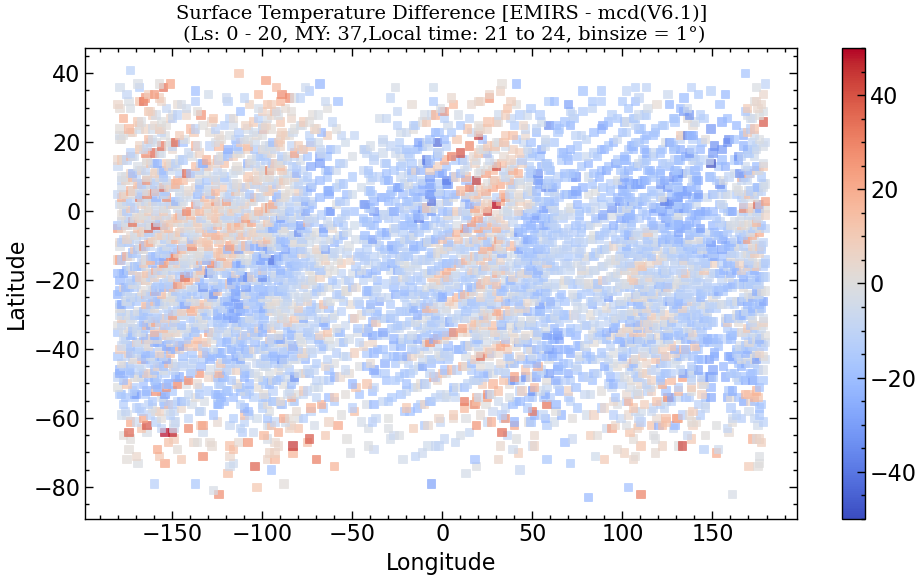

In [32]:
# grouping by latitude and longitude
start_time = 21
end_time = 24

plt.figure(figsize=(10, 6))  

temp_df_2124 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_2124 = temp_df_2124[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_2124, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_21_24_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

## Compative Analysis of Correlation

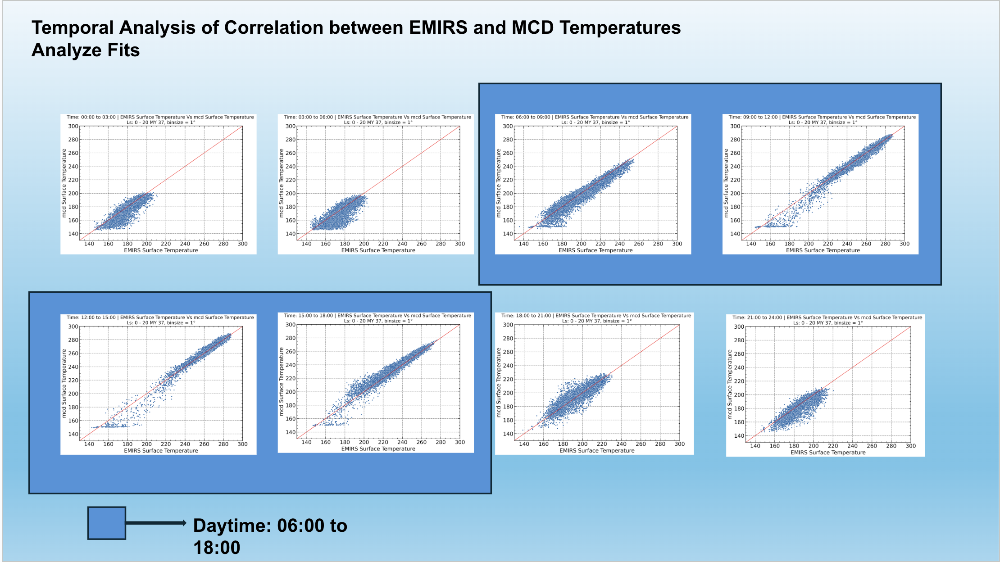

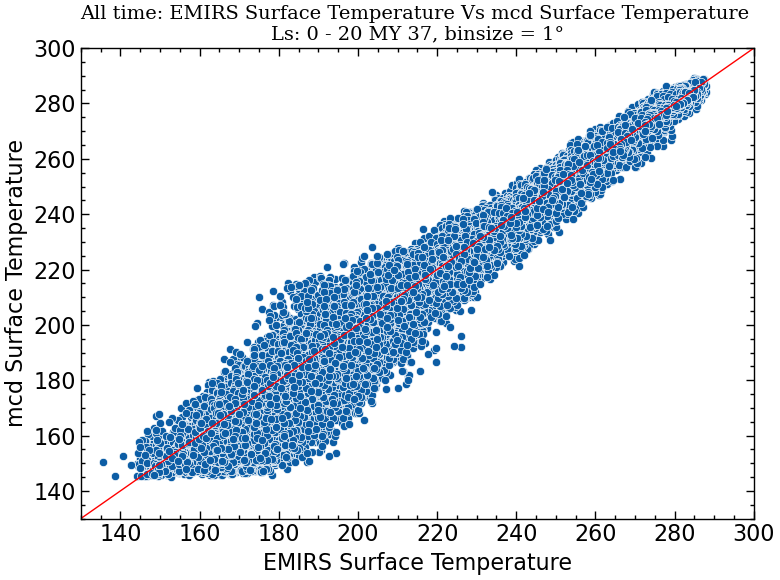

In [33]:

sns.scatterplot(data = merged_df, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("All time: EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_All_Time'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [34]:
merged_df[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.986253
temp_mcd,0.986253,1.000000


In [35]:
corr_all = round(merged_df[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_all

0.986253

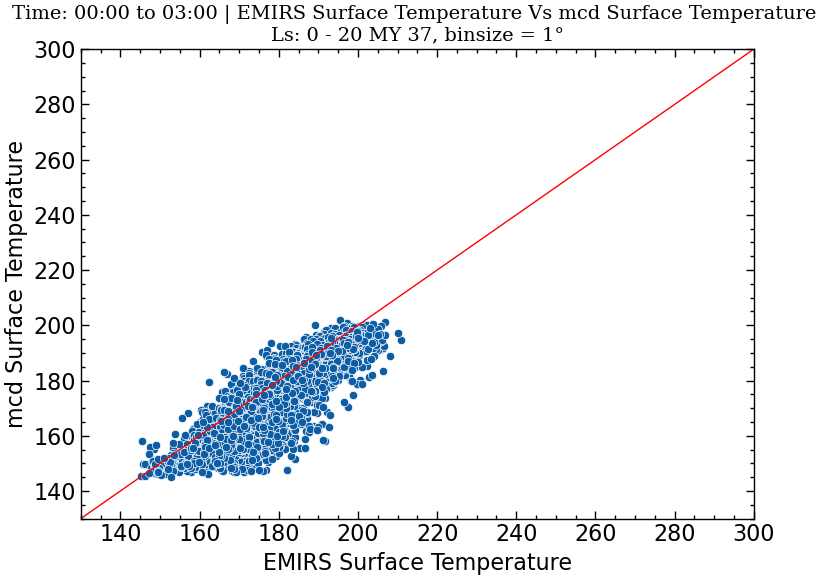

In [36]:
sns.scatterplot(data = temp_df_03, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("Time: 00:00 to 03:00 | EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_0_to_3'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [37]:
temp_df_03[['tsurf', 'temp_mcd']].corr()


,tsurf,temp_mcd
tsurf,1.000000,0.880711
temp_mcd,0.880711,1.000000


In [38]:
corr_03 = round(temp_df_03[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_03

0.880711

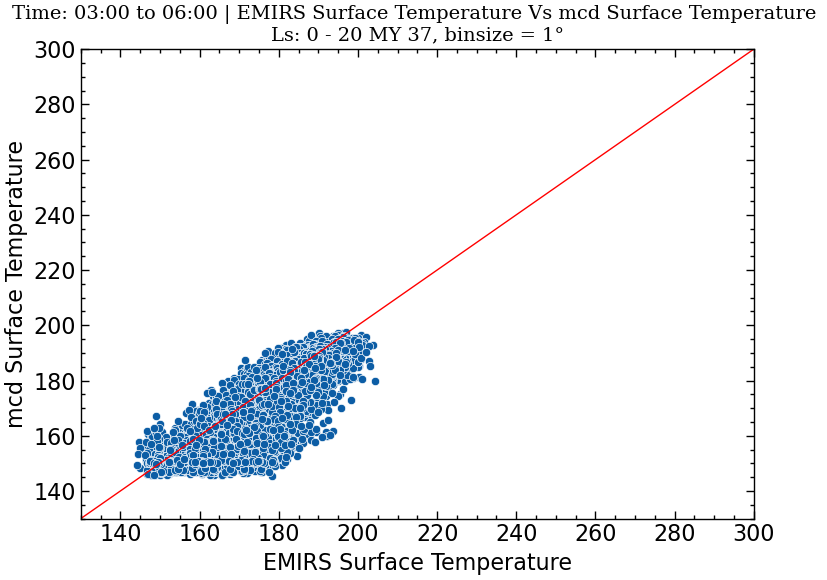

In [39]:
sns.scatterplot(data = temp_df_36, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("Time: 03:00 to 06:00 | EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_3_to_6'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [40]:
temp_df_36[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.838624
temp_mcd,0.838624,1.000000


In [41]:
corr_36 = round(temp_df_36[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_36

0.838624

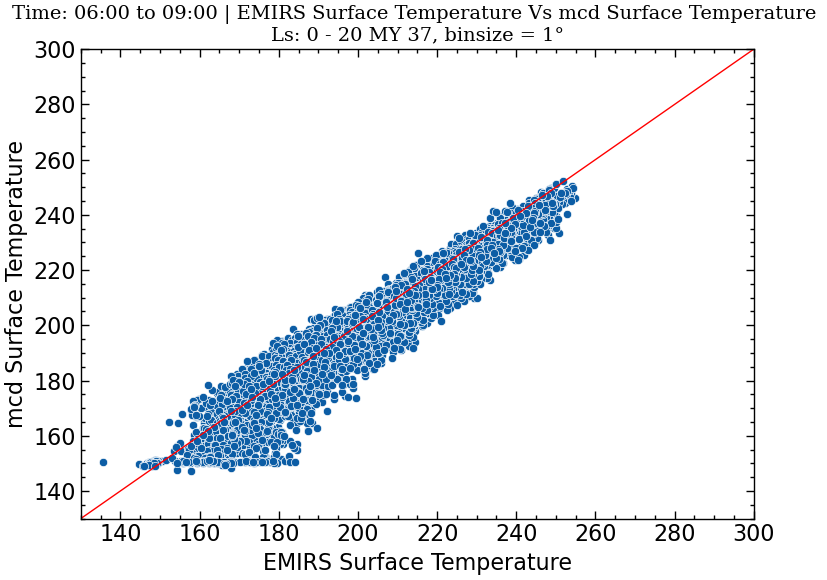

In [42]:
sns.scatterplot(data = temp_df_69, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("Time: 06:00 to 09:00 | EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_6_to_9'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [43]:
temp_df_69[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.958258
temp_mcd,0.958258,1.000000


In [44]:
corr_69 = round(temp_df_69[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_69

0.958258

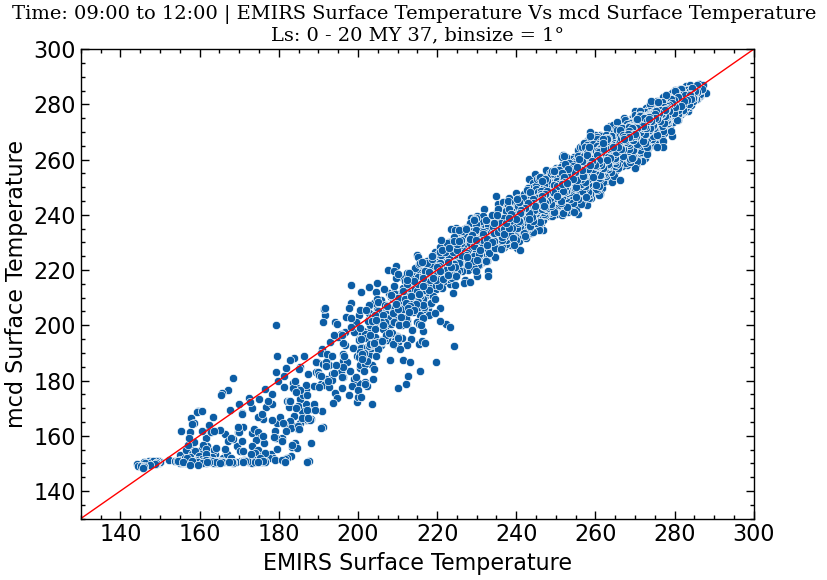

In [45]:
sns.scatterplot(data = temp_df_912, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("Time: 09:00 to 12:00 | EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_9_to_12'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [46]:
temp_df_912[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.986298
temp_mcd,0.986298,1.000000


In [47]:
corr_912 = round(temp_df_912[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_912

0.986298

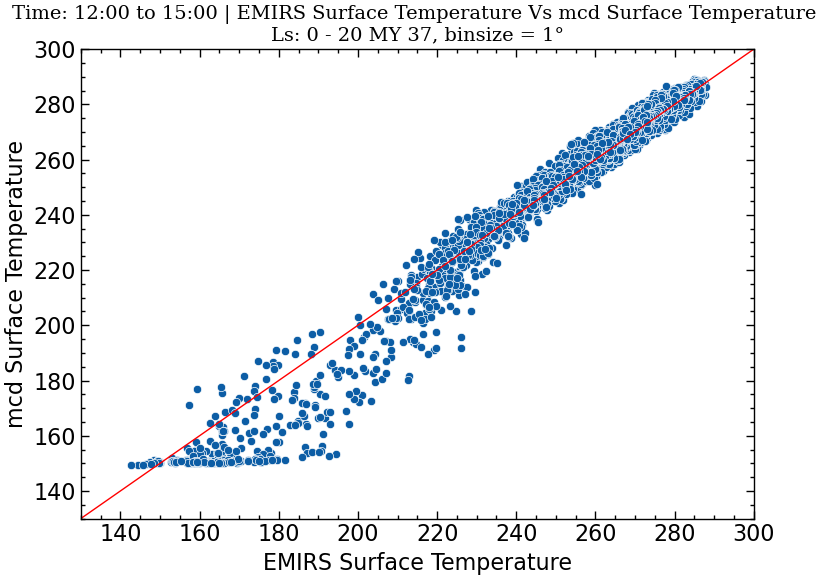

In [48]:
sns.scatterplot(data = temp_df_1215, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("Time: 12:00 to 15:00 | EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_12_to_15'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [49]:
temp_df_1215[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.985851
temp_mcd,0.985851,1.000000


In [50]:
corr_1215 = round(temp_df_1215[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_1215

0.985851

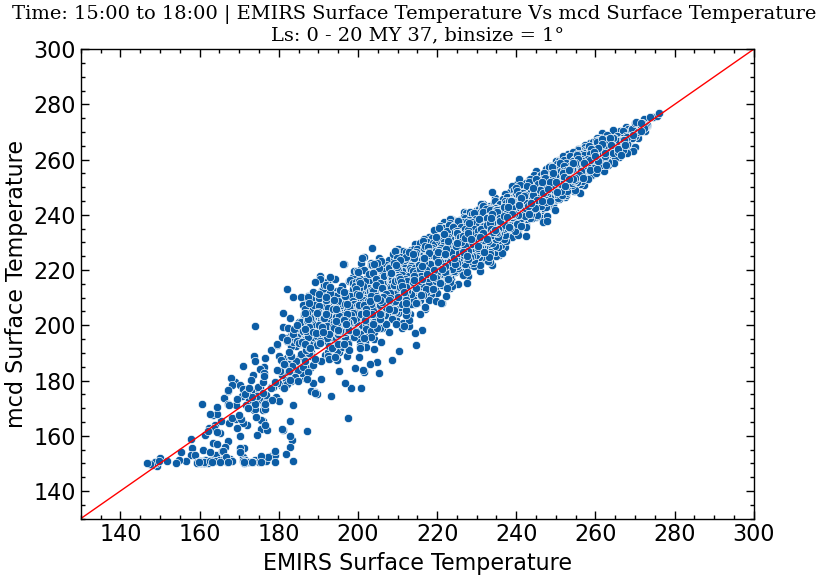

In [51]:
sns.scatterplot(data = temp_df_1518, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("Time: 15:00 to 18:00 | EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_15_to_18'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [52]:
temp_df_1518[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.971345
temp_mcd,0.971345,1.000000


In [53]:
corr_1518 = round(temp_df_1518[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_1518

0.971345

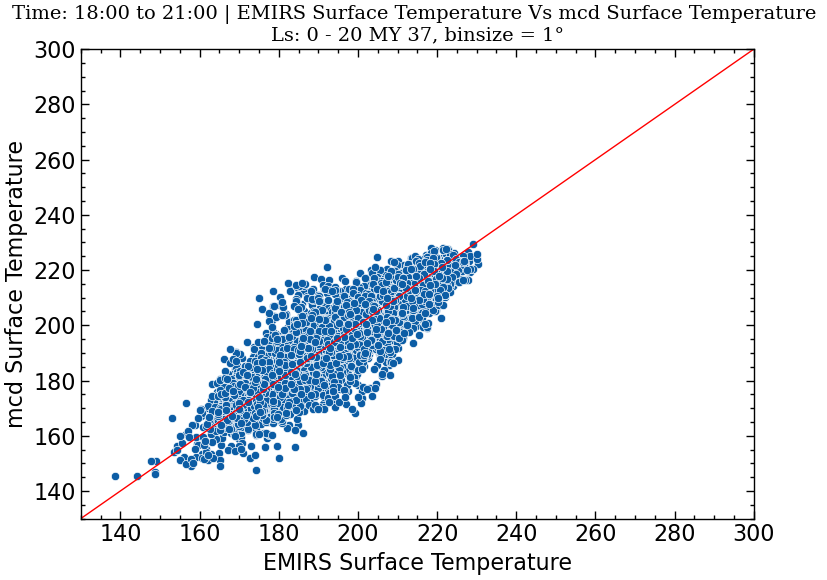

In [54]:
sns.scatterplot(data = temp_df_1821, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("Time: 18:00 to 21:00 | EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_12_to_15'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [55]:
temp_df_1821[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.00000,0.87693
temp_mcd,0.87693,1.00000


In [56]:
corr_1821 = round(temp_df_1821[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_1821

0.87693

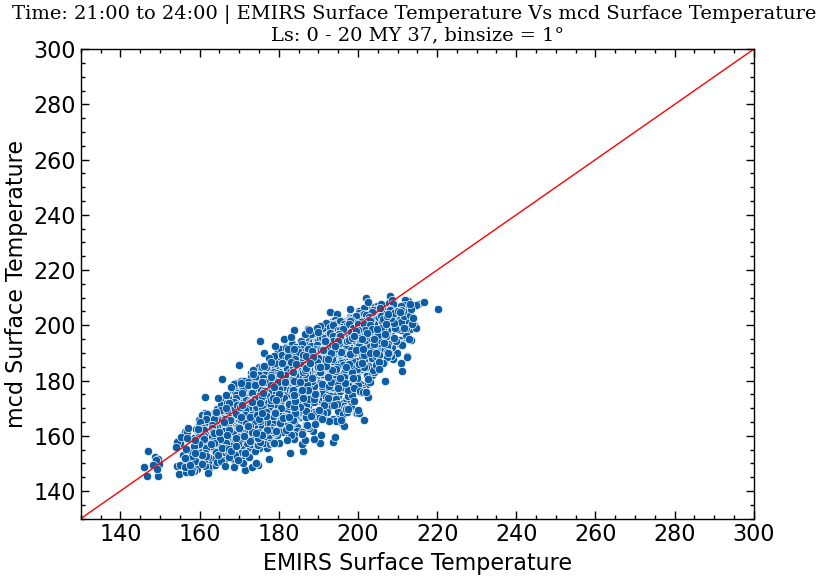

In [57]:
sns.scatterplot(data = temp_df_2124, x = 'tsurf', y = 'temp_mcd')
plt.axline((0, 0), (1, 1), linewidth=1, color='r')
plt.xlabel('EMIRS Surface Temperature')
plt.ylabel('mcd Surface Temperature')
plt.xlim([130,300])
plt.ylim([130,300])
plt.title("Time: 21:00 to 24:00 | EMIRS Surface Temperature Vs mcd Surface Temperature \n\
Ls: 0 - 20 MY 37, binsize = 1\u00b0", fontsize=14, fontfamily="serif", color="black")

filename_save = 'Plots/Emirs_Vs_mcd_binsize1_21_to_24'
plt.tight_layout()
plt.savefig(filename_save, format='pdf')

plt.show()

In [58]:
temp_df_2124[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.857362
temp_mcd,0.857362,1.000000


In [59]:
corr_2124 = round(temp_df_2124[['tsurf', 'temp_mcd']].corr().loc['temp_mcd', 'tsurf'], 6)
corr_2124

0.857362

In [60]:
# Create correlation list and time list

time = ['0-3', '3-6', '6-9', '9-12', '12-15', '15-18', '18-21', '21-24']
corr_list = [corr_03, corr_36, corr_69, corr_912, corr_1215, corr_1518, corr_1821, corr_2124]
corr_list

[0.880711, 0.838624, 0.958258, 0.986298, 0.985851, 0.971345, 0.87693, 0.857362]

In [61]:
# Calculate percent change

pct_change_list = [0]
for i in range(1, len(corr_list)):
    previous_value = corr_list[i-1]
    current_value = corr_list[i]
    if previous_value != 0:  # Avoid division by zero
        pct_change = ((current_value - previous_value) / previous_value) * 100
        pct_change_list.append(pct_change)
    else:
        pct_change_list.append(float('inf') if current_value > 0 else float('-inf') if current_value < 0 else 0)

print(pct_change_list)

[0, -4.778752621461522, 14.26551112298241, 2.9261430637677903, -0.045320988180040434, -1.471419108972859, -9.720027384708835, -2.2314209800098106]


In [62]:
# Cross check lengths 

len(corr_list), len(pct_change_list), len(time)

(8, 8, 8)

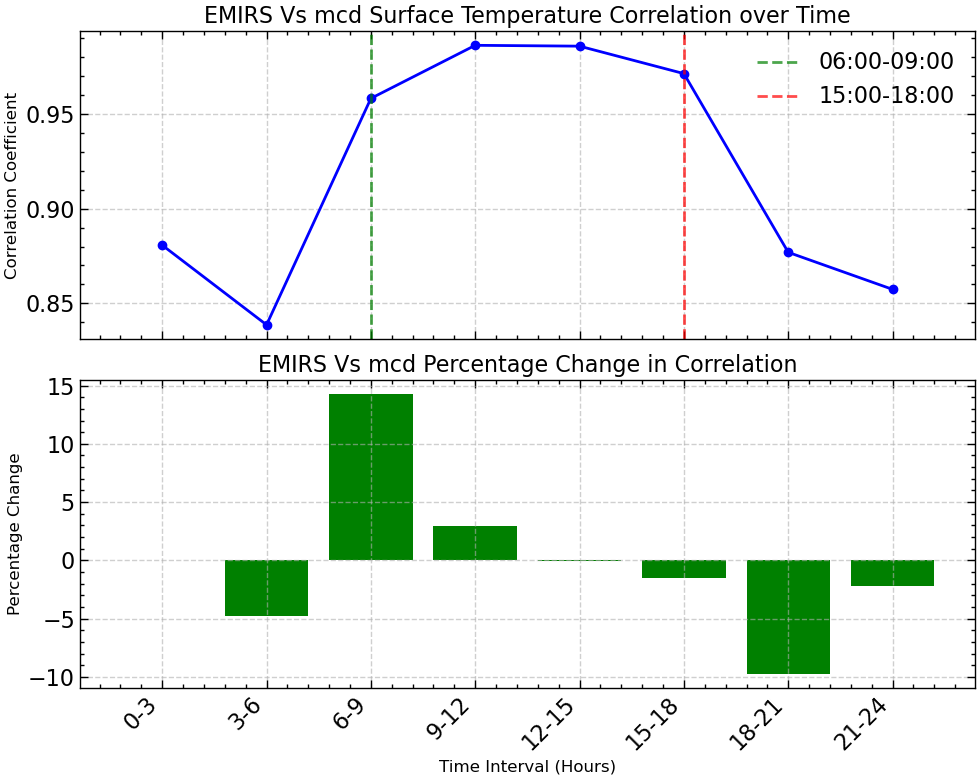

In [63]:
# Create subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8), sharex=True)

# Plot corr_list
ax1.plot(time, corr_list, marker='o', color='blue')
ax1.set_title('EMIRS Vs mcd Surface Temperature Correlation over Time', fontsize=16)
ax1.set_ylabel('Correlation Coefficient', fontsize=12)
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.axvline(x='6-9', color='green', linestyle='--', alpha=0.7, label = '06:00-09:00')
ax1.axvline(x='15-18', color='red', linestyle='--', alpha=0.7, label = '15:00-18:00')
ax1.legend()

# Plot pct_change_list
ax2.bar(time, pct_change_list, color='green')
ax2.set_title('EMIRS Vs mcd Percentage Change in Correlation', fontsize=16)
ax2.set_xlabel('Time Interval (Hours)', fontsize=12)
ax2.set_ylabel('Percentage Change', fontsize=12)
ax2.grid(True, linestyle='--', alpha=0.6)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')


filename_save = 'Plots/Emirs_Vs_mcd_temporal_correlation_plot'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

# Show the plot
plt.show()

## Questions Based on these findings

1. How does this vary diurnally
2. By how much does EMIRS data vary diurnally

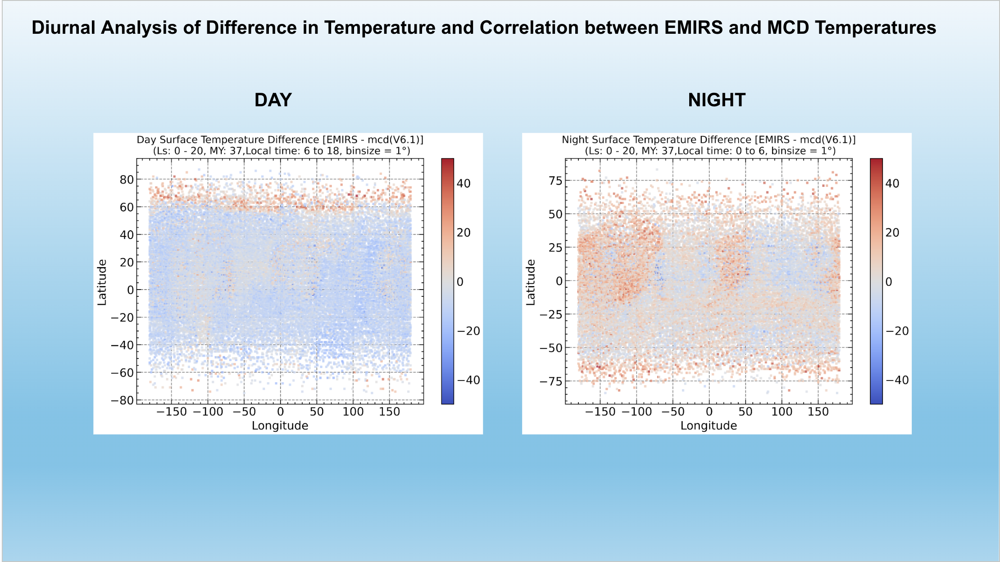

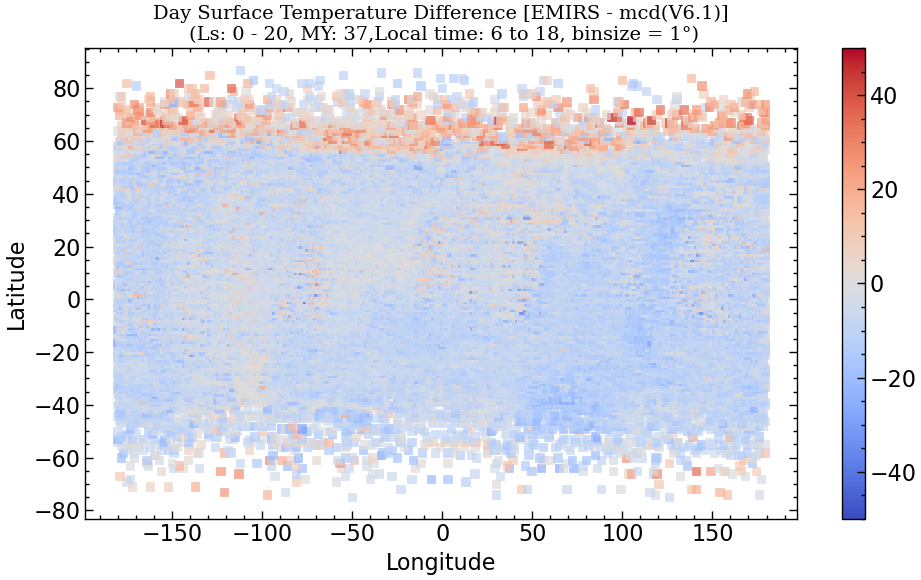

In [65]:
# grouping by latitude and longitude
start_time = 6
end_time = 18

plt.figure(figsize=(10, 6))  

temp_df_618 = merged_df[(merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)]
temp_df_618 = temp_df_618[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_618, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Day Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_21_24_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

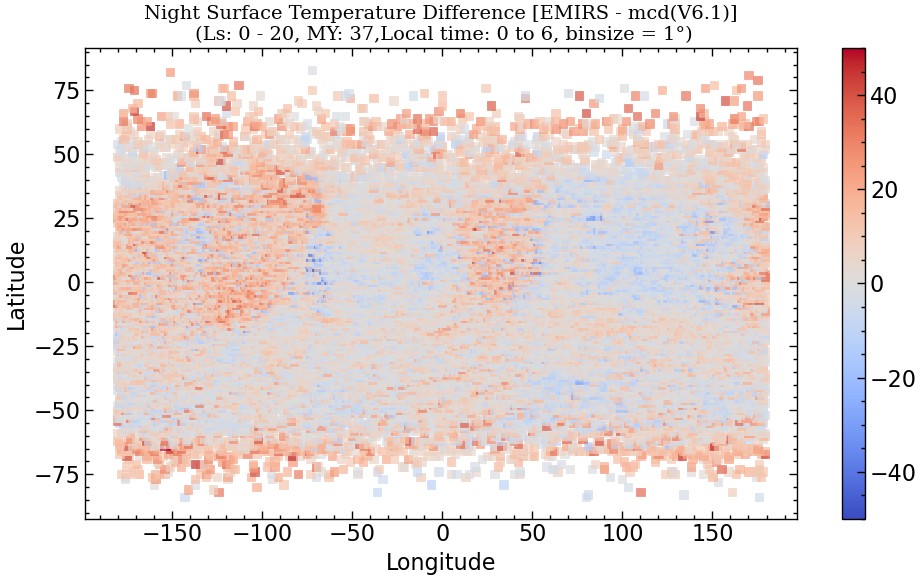

In [66]:
# grouping by latitude and longitude
start_time = 0
end_time = 6

plt.figure(figsize=(10, 6))  

st2 = 18
end2 = 24

con1 = (merged_df['qlt_x'] >=start_time) & (merged_df['qlt_x'] < end_time)
con2 = (merged_df['qlt_x'] >=st2) & (merged_df['qlt_x'] < end2)
temp_df_186 = merged_df[con1 | con2]
temp_df_186 = temp_df_186[['latitude_fl', 'longitude_fl', 
                  'tsurf', 'temp_mcd', 'diff_emirs', 'diff_mcd']].groupby(by = ['latitude_fl', 
                                          'longitude_fl'], as_index=False).mean()

ax = sns.scatterplot(data = temp_df_186, 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')

norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

ax.get_legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.title(f'Night Surface Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_21_24_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

In [67]:
temp_df_618[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.986265
temp_mcd,0.986265,1.000000


In [68]:
temp_df_186[['tsurf', 'temp_mcd']].corr()

,tsurf,temp_mcd
tsurf,1.000000,0.902974
temp_mcd,0.902974,1.000000


### How many times has EMIRs measured lower temperature


In [69]:
def return_low_up(x):
    if x < 0:
        return 'Lower'
    return 'Higher'

In [70]:
temp_df_186['lowup'] = temp_df_186['diff_emirs'].apply(return_low_up)
temp_df_618['lowup'] = temp_df_618['diff_emirs'].apply(return_low_up)


/tmpdata/ipykernel_1573652/1521146799.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=lowup_counts.index, y=lowup_counts.values, palette="viridis") # Choose a professional color palette


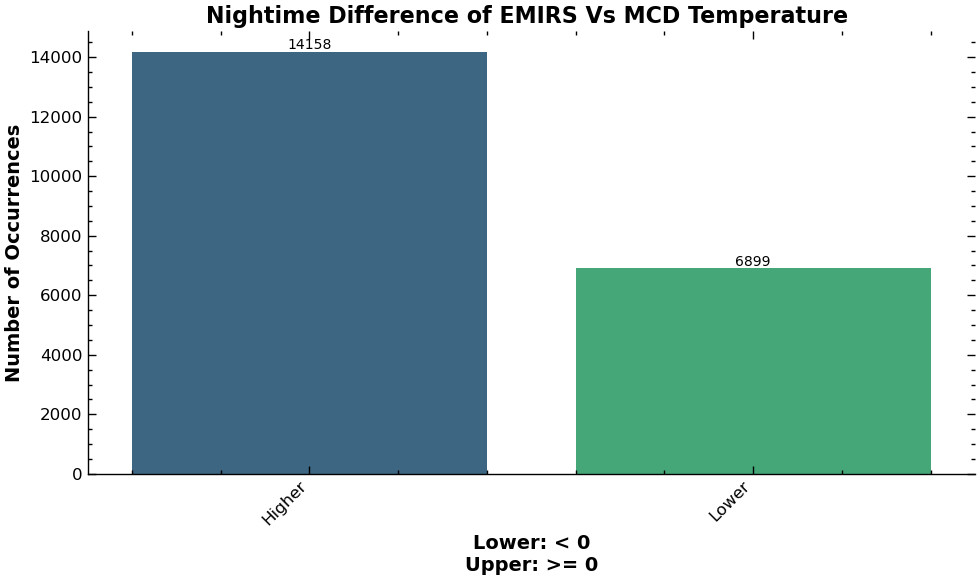

In [71]:
# Assuming temp_df_186 is your DataFrame and 'lowup' is the column of interest

# Get the value counts
lowup_counts = temp_df_186['lowup'].value_counts()
plt.style.use(['science', 'notebook'])
# Set a professional style using Seaborn (which builds on Matplotlib)
plt.figure(figsize=(10, 6))  # Adjust figure size for better readability

# Create the bar chart with improved aesthetics
ax = sns.barplot(x=lowup_counts.index, y=lowup_counts.values, palette="viridis") # Choose a professional color palette

# Add labels and title with clear formatting
plt.xlabel("Lower: < 0\nUpper: >= 0", fontsize=14, fontweight='bold')
plt.ylabel("Number of Occurrences", fontsize=14, fontweight='bold')
plt.title("Nightime Difference of EMIRS Vs MCD Temperature ", fontsize=16, fontweight='bold')

# Rotate x-axis labels for better readability if there are many categories
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Add value labels on top of the bars for precise data reading
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                textcoords='offset points')

# Remove spines for a cleaner look (optional)
sns.despine(top=True, right=True, left=False, bottom=False)

# Adjust layout to prevent labels from being cut off
plt.tight_layout()

# Display the plot
plt.show()

/tmpdata/ipykernel_1573652/1649716082.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=lowup_counts.index, y=lowup_counts.values, palette="viridis") # Choose a professional color palette


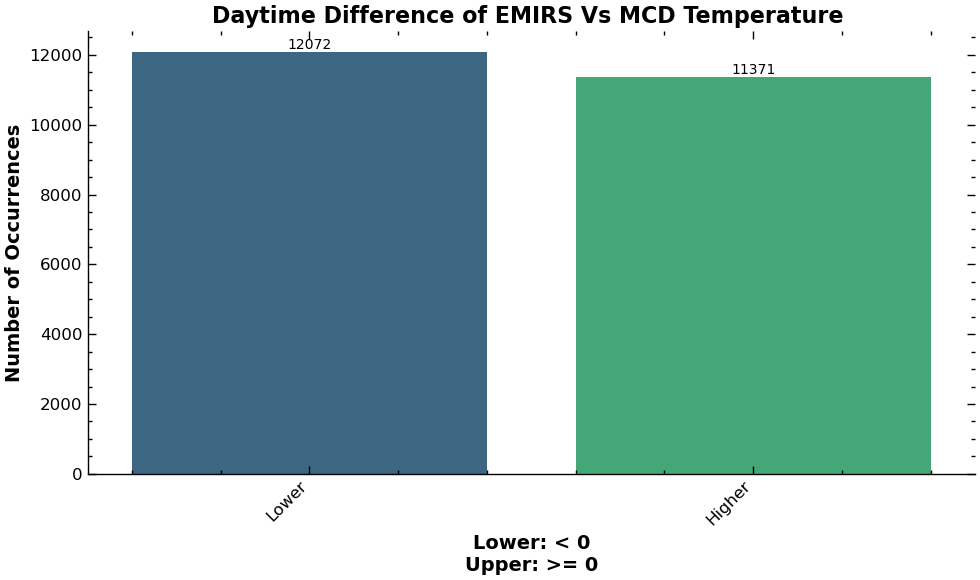

In [72]:
# Assuming temp_df_186 is your DataFrame and 'lowup' is the column of interest

# Get the value counts
lowup_counts = temp_df_618['lowup'].value_counts()
plt.style.use(['science', 'notebook'])
# Set a professional style using Seaborn (which builds on Matplotlib)
plt.figure(figsize=(10, 6))  # Adjust figure size for better readability

# Create the bar chart with improved aesthetics
ax = sns.barplot(x=lowup_counts.index, y=lowup_counts.values, palette="viridis") # Choose a professional color palette

# Add labels and title with clear formatting
plt.xlabel("Lower: < 0\nUpper: >= 0", fontsize=14, fontweight='bold')
plt.ylabel("Number of Occurrences", fontsize=14, fontweight='bold')
plt.title("Daytime Difference of EMIRS Vs MCD Temperature ", fontsize=16, fontweight='bold')

# Rotate x-axis labels for better readability if there are many categories
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Add value labels on top of the bars for precise data reading
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                textcoords='offset points')

# Remove spines for a cleaner look (optional)
sns.despine(top=True, right=True, left=False, bottom=False)

# Adjust layout to prevent labels from being cut off
plt.tight_layout()

# Display the plot
plt.show()

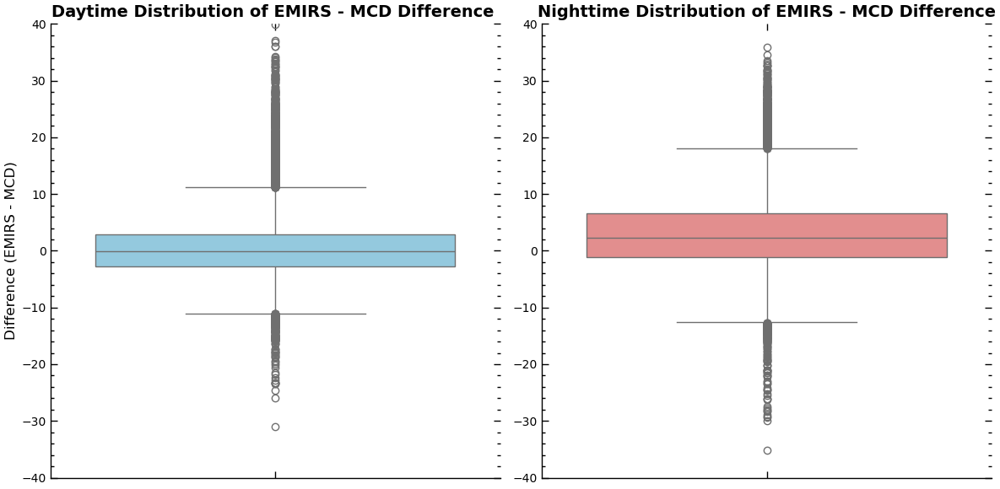

In [73]:
plt.figure(figsize=(12, 6))  # Adjust figure size for better horizontal layout

# Subplot 1: temp_df_618['diff_emirs']
plt.subplot(1, 2, 1)  # 1 row, 2 columns, first subplot
sns.boxplot(y=temp_df_618['diff_emirs'], color='skyblue')
plt.ylabel('Difference (EMIRS - MCD)', fontsize=12)
plt.title('Daytime Distribution of EMIRS - MCD Difference ', fontsize=14, fontweight='bold')
plt.ylim([-40, 40])
sns.despine(top=True, right=True, left=False, bottom=False)
plt.yticks(fontsize=10)

# Subplot 2: temp_df_186['diff_emirs']
plt.subplot(1, 2, 2)  # 1 row, 2 columns, second subplot
sns.boxplot(y=temp_df_186['diff_emirs'], color='lightcoral')
plt.ylabel('')  # Remove redundant y-axis label
plt.ylim([-40, 40])
plt.title('Nighttime Distribution of EMIRS - MCD Difference', fontsize=14, fontweight='bold')
sns.despine(top=True, right=True, left=False, bottom=False)
plt.yticks(fontsize=10)

# Add a common x-axis label if needed (though boxplots don't typically use one for single variables)
# plt.xlabel('Dataset', fontsize=12, fontweight='bold')

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()

In [74]:
# Where are my outliers
con_o1 = (temp_df_618['diff_emirs'] > 10) | (temp_df_618['diff_emirs'] < -10)
temp_df_618[con_o1]

,latitude_fl,longitude_fl,tsurf,temp_mcd,diff_emirs,diff_mcd,lowup
2,-74.0,-97.0,182.934858,165.460083,17.474775,-17.474775,Higher
5,-74.0,158.0,170.373259,154.397964,15.975294,-15.975294,Higher
7,-73.0,-121.0,181.158097,157.189331,23.968766,-23.968766,Higher
10,-73.0,154.0,171.895468,153.711166,18.184302,-18.184302,Higher
12,-72.0,44.0,176.283155,162.769714,13.513441,-13.513441,Higher
...,...,...,...,...,...,...,...
23420,82.0,-108.0,167.852082,150.030029,17.822053,-17.822053,Higher
23432,83.0,58.0,159.485594,149.242188,10.243406,-10.243406,Higher
23433,83.0,100.0,166.132946,149.643311,16.489635,-16.489635,Higher
23437,84.0,138.0,166.711995,149.723389,16.988607,-16.988607,Higher


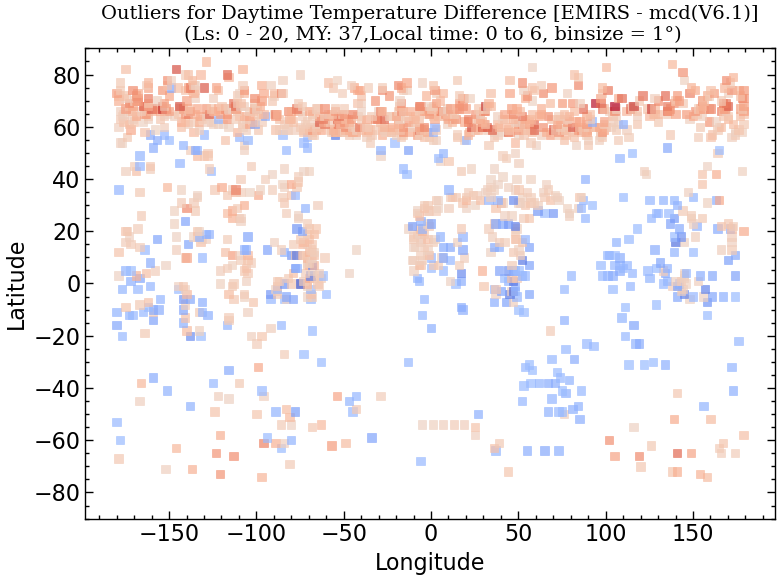

In [75]:
sns.scatterplot(data = temp_df_618[con_o1], 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')
norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

plt.legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.ylim([-90, 90])

plt.title(f'Outliers for Daytime Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_21_24_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

In [76]:
# Where are my outliers
con_o2 = (temp_df_186['diff_emirs'] > 10) | (temp_df_186['diff_emirs'] < -10)
temp_df_186[con_o2]

,latitude_fl,longitude_fl,tsurf,temp_mcd,diff_emirs,diff_mcd,lowup
5,-82.0,-124.0,171.489007,147.538422,23.950586,-23.950586,Higher
7,-82.0,110.0,174.822400,149.306946,25.515454,-25.515454,Higher
9,-81.0,-141.0,172.963514,156.142761,16.820753,-16.820753,Higher
11,-80.0,-103.0,167.795023,152.752380,15.042642,-15.042642,Higher
20,-77.0,-159.0,182.711659,163.787033,18.924626,-18.924626,Higher
...,...,...,...,...,...,...,...
21051,77.0,-113.0,175.009352,150.782196,24.227156,-24.227156,Higher
21052,77.0,151.0,160.876633,150.290329,10.586304,-10.586304,Higher
21053,79.0,175.0,174.751643,150.712006,24.039638,-24.039638,Higher
21054,81.0,170.0,171.459384,150.317276,21.142108,-21.142108,Higher


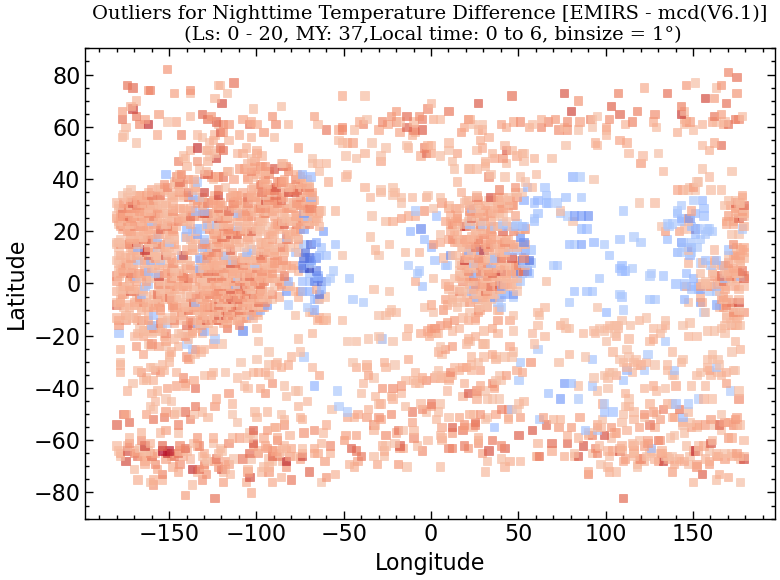

In [78]:
sns.scatterplot(data = temp_df_186[con_o2], 
                     x = 'longitude_fl', y = 'latitude_fl', 
                     palette = 'coolwarm', hue = 'diff_emirs', ec = None, alpha = 0.7, marker='s')
norm = plt.Normalize(vmin=-50, vmax=50)
sm = plt.cm.ScalarMappable(cmap = 'coolwarm' , norm=norm)
sm.set_array([])

cbar = plt.colorbar(sm, ax=ax)
#cbar.set_label("Surface Temperature (tsurf)")  # Optional label

plt.legend().remove()
#ax.figure.colorbar(sm)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.ylim([-90, +90])

plt.title(f'Outliers for Nighttime Temperature Difference [EMIRS - mcd(V6.1)]\n (Ls: 0 - 20, MY: 37,\
Local time: {start_time} to {end_time}, binsize = 1\u00b0)',fontsize=14, fontfamily="serif", color="black")
filename_save = 'Plots/Emirs_Surface_Temperature_Difference_from_mcd_v6_1_Ls_0_20_Time_21_24_binsize1'
plt.tight_layout()
#plt.savefig(filename_save, format='pdf')

plt.show()

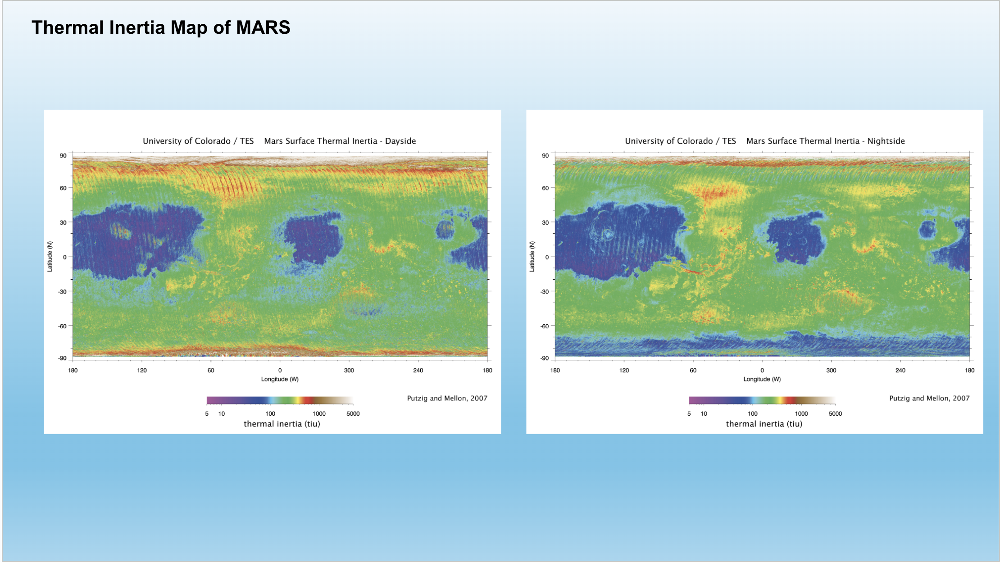

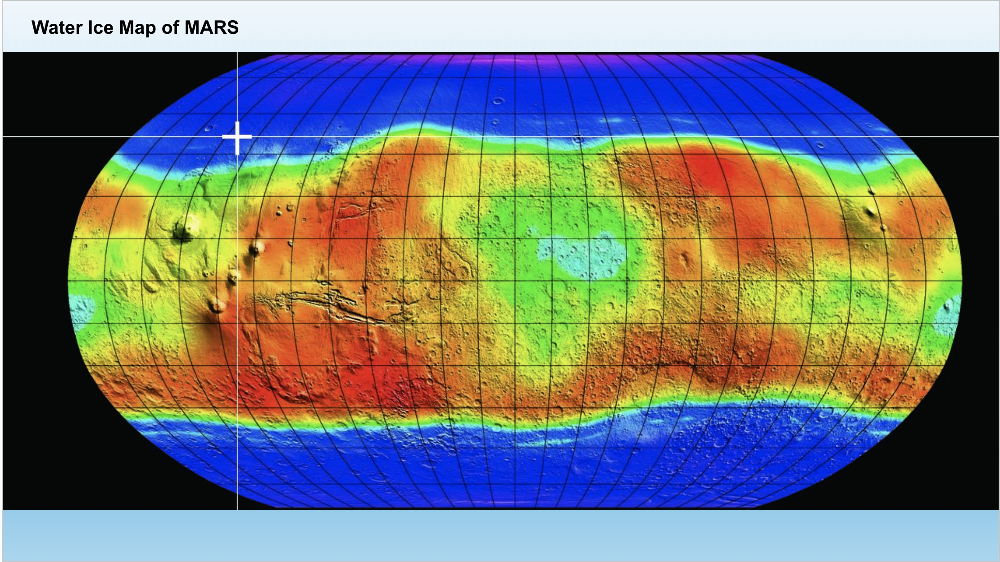

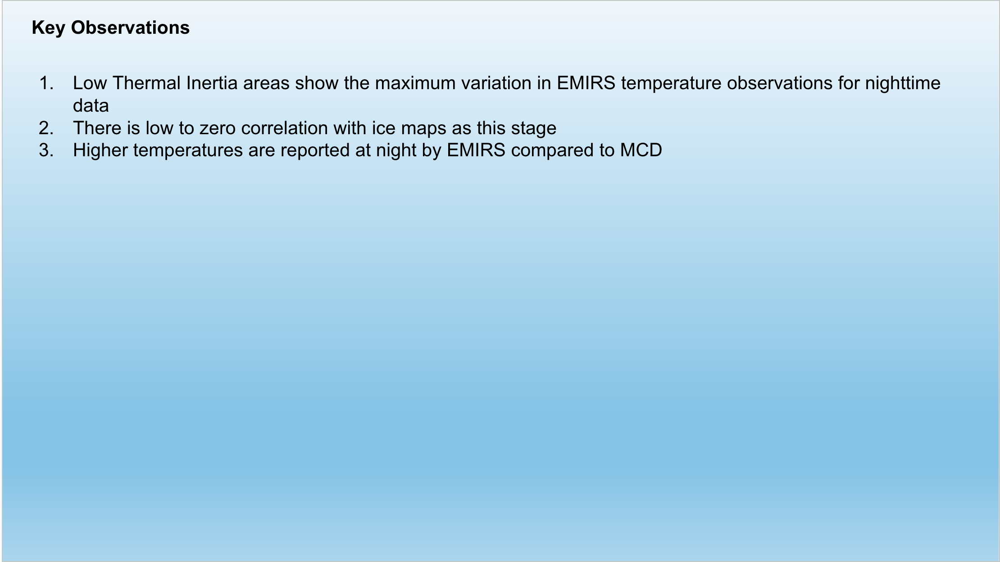